In [1]:
import napari
from napari.utils import nbscreenshot

viewer = napari.Viewer()

Validation errors in config file(s).
The following fields have been reset to the default value:

plugins -> call_order
  none is not an allowed value (type=type_error.none.not_allowed)



In [2]:
viewer.open('data/nuclei.tif')

[<Image layer 'nuclei' at 0x7f8b715f9070>]

In [3]:
viewer.dims.current_step = (30, 0, 0)

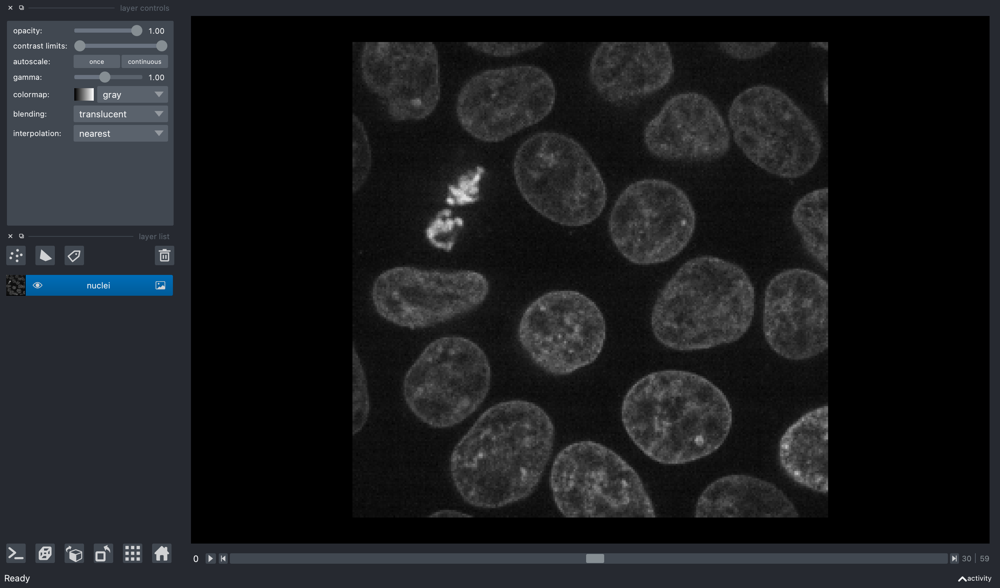

In [4]:
nbscreenshot(viewer)

In [5]:
# add the first points layer for dividing cells
viewer.add_points(name='dividing', face_color='red', n_dimensional=True, ndim=3);

# add the second points layer for non-dividing cells
viewer.add_points(name='non-dividing', face_color='blue', n_dimensional=True, ndim=3);

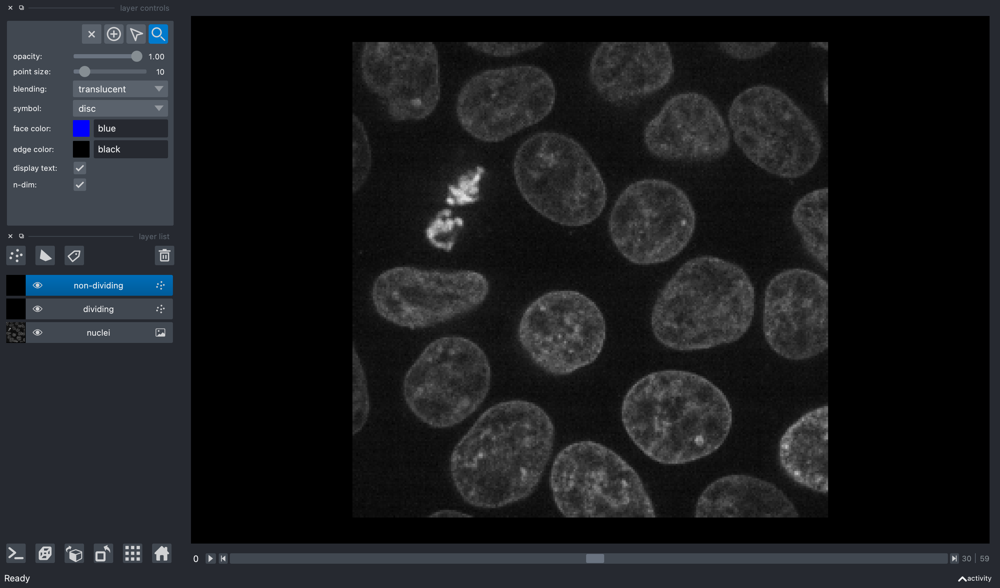

In [6]:
nbscreenshot(viewer)

In [7]:
# programatically enter add mode for both Points layers to enable editing
viewer.layers['dividing'].mode = 'add'
viewer.layers['non-dividing'].mode = 'add'

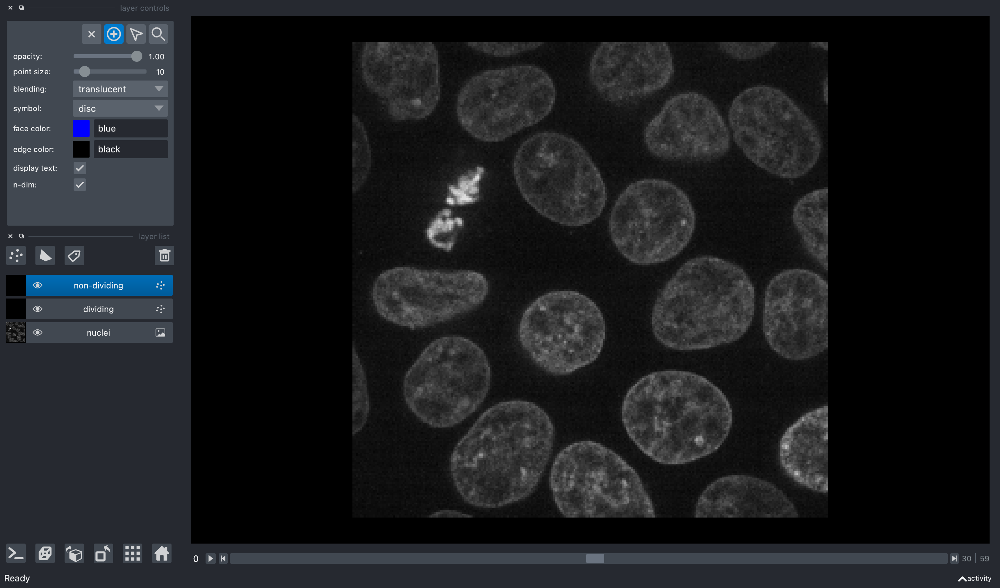

In [8]:
nbscreenshot(viewer)

In [9]:
viewer.layers['dividing'].add([30, 88.1365794 , 54.39650486])
viewer.layers['non-dividing'].add(
      [[30,  13.90840911,  27.02955319],
       [30,  32.27800681,  82.51323603],
       [30,  11.28418087, 148.86872159],
       [30,  46.52381727, 182.60879899],
       [30,  73.89076894, 108.3806287 ],
       [30,  96.00926413, 160.11541406],
       [30,  47.64848652, 226.09600987],
       [30, 142.12070325, 186.73258623],
       [30, 145.86960074, 242.59115882],
       [30, 200.97839383, 173.61144502],
       [30, 154.49206496, 112.87930569],
       [30, 135.74757752,  39.77580465],
       [30, 182.60879613,  52.14716636],
       [30, 221.97221977,  82.13834628],
       [30, 241.09159696, 136.12247012],
       [30, 250.46384069, 209.60086091]]
   )

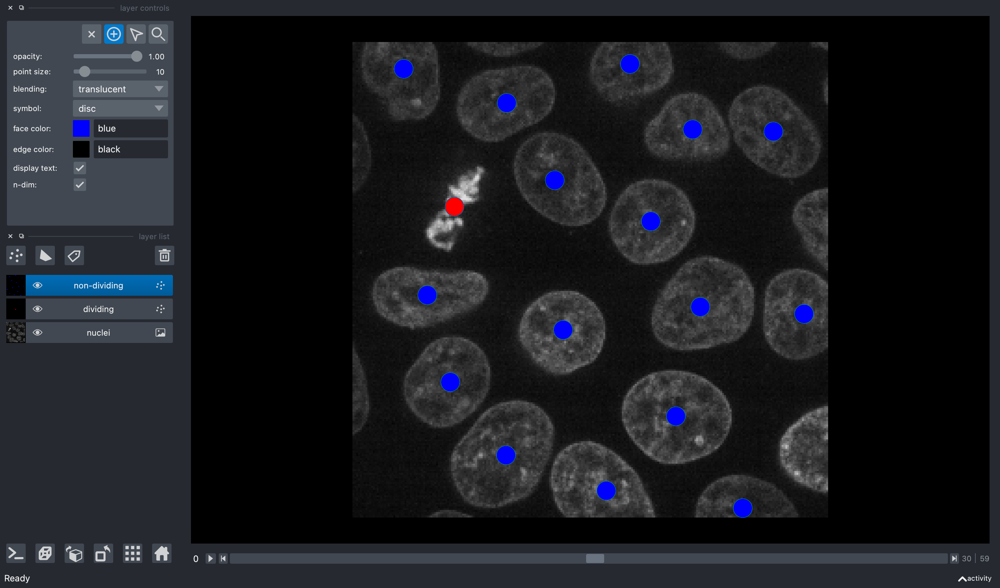

In [10]:
nbscreenshot(viewer)

In [11]:
viewer.dims.ndisplay = 3
viewer.camera.angles = (-10, 30, 135)

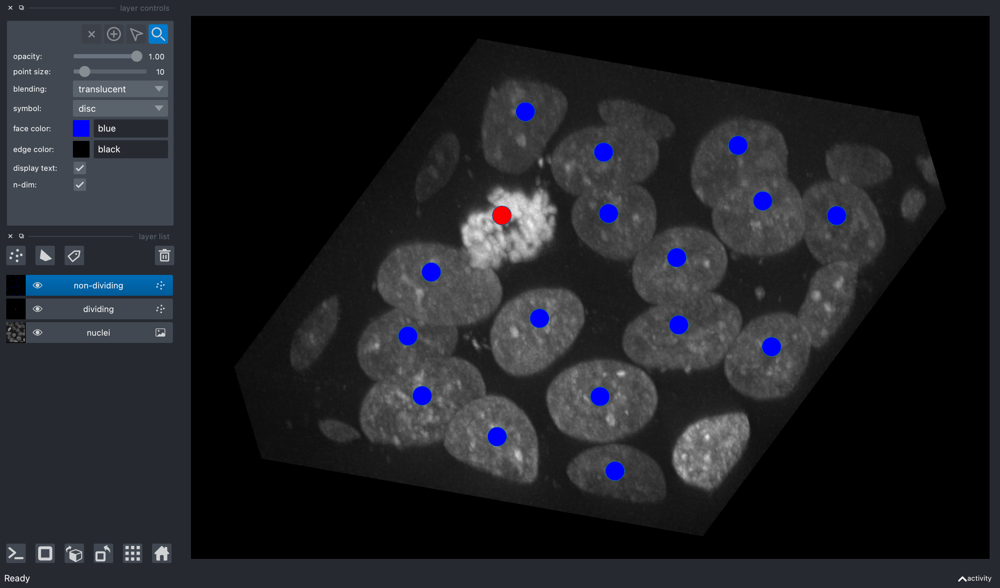

In [12]:
nbscreenshot(viewer)

In [13]:
print('Number of diving cells:', len(viewer.layers['dividing'].data))
print('Number of non-diving cells:', len(viewer.layers['non-dividing'].data))

Number of diving cells: 1
Number of non-diving cells: 16


In [14]:
# Locations of non-dividing cells
viewer.layers['non-dividing'].data

array([[ 30.        ,  13.90840911,  27.02955319],
       [ 30.        ,  32.27800681,  82.51323603],
       [ 30.        ,  11.28418087, 148.86872159],
       [ 30.        ,  46.52381727, 182.60879899],
       [ 30.        ,  73.89076894, 108.3806287 ],
       [ 30.        ,  96.00926413, 160.11541406],
       [ 30.        ,  47.64848652, 226.09600987],
       [ 30.        , 142.12070325, 186.73258623],
       [ 30.        , 145.86960074, 242.59115882],
       [ 30.        , 200.97839383, 173.61144502],
       [ 30.        , 154.49206496, 112.87930569],
       [ 30.        , 135.74757752,  39.77580465],
       [ 30.        , 182.60879613,  52.14716636],
       [ 30.        , 221.97221977,  82.13834628],
       [ 30.        , 241.09159696, 136.12247012],
       [ 30.        , 250.46384069, 209.60086091]])

In [15]:
# Save out Points layer data to a csv file
viewer.layers['dividing'].save('dividing.csv', plugin='builtins')
viewer.layers['non-dividing'].save('non-dividing.csv', plugin='builtins')

['/Users/aburt/Programming/napari-workshop/napari-workshops/notebooks/non-dividing.csv']

In [16]:
# Take the maximum intensity projection of the cells
nuclei_mip = viewer.layers['nuclei'].data.max(axis=0)

In [17]:
# Remove select and remove all the current layers from the viewer
viewer.layers.select_all()
viewer.layers.remove_selected()

# Add in the maximum intensity projection
viewer.add_image(nuclei_mip);

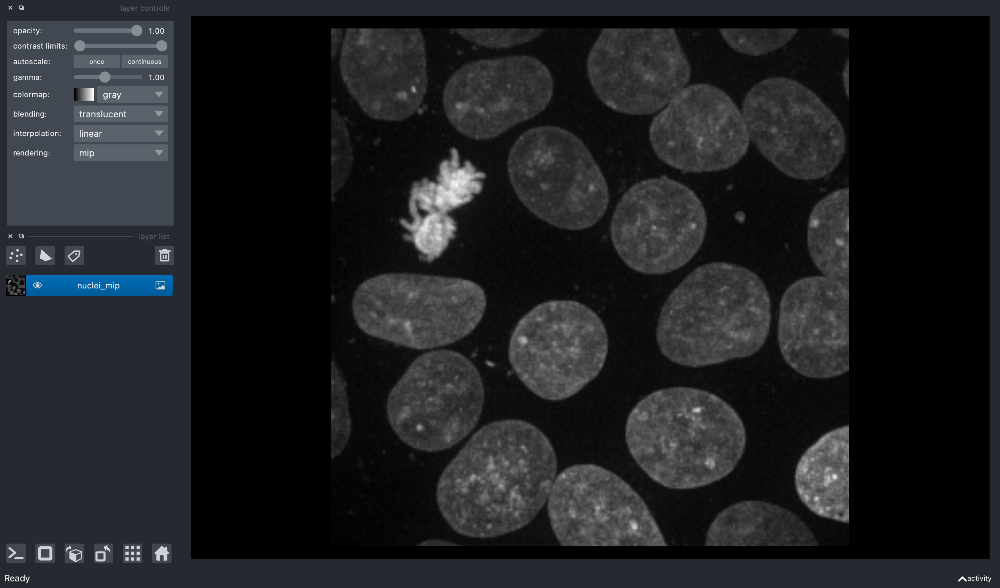

In [18]:
nbscreenshot(viewer)

In [19]:
viewer.add_shapes(name='nuclei outlines', face_color='red', edge_color='white', opacity=0.7)

<Shapes layer 'nuclei outlines' at 0x7f8b94879370>

ValueError: Last dimension should be 3 not 4

ValueError: Last dimension should be 3 not 4

ValueError: Last dimension should be 3 not 4

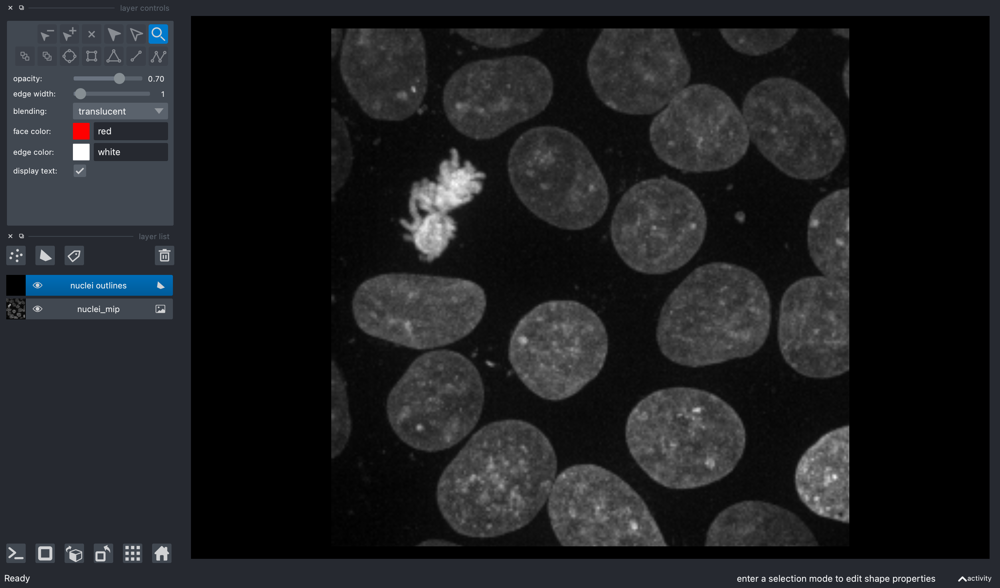

In [20]:
nbscreenshot(viewer)

In [21]:
p1 = [[142.12070325,  94.13481824],
      [150.36827772,  89.26125151],
      [163.86430869,  87.76169251],
      [179.98456789, 100.88283373],
      [182.98368588, 113.25419544],
      [173.98633191, 124.87577766],
      [163.86430869, 133.87313163],
      [148.49382898, 135.37269063],
      [137.99691601, 128.2497854 ],
      [132.74845952, 116.25331343],
      [134.24801852, 103.50706197]]
p2 = [[ 87.01191015, 140.24625736],
      [ 97.13393338, 136.49735987],
      [109.50529509, 140.24625736],
      [118.12775932, 149.99339083],
      [120.37709781, 163.4894218 ],
      [114.75375158, 174.73611426],
      [104.25683861, 181.48412974],
      [ 93.75992564, 184.10835799],
      [ 80.26389467, 179.609681  ],
      [ 73.89076894, 166.11365004],
      [ 74.26565869, 152.24272933],
      [ 78.38944593, 145.1198241 ]]
p3 = [[ 48.02337627, 108.3806287 ],
      [ 48.02337627,  97.13393624],
      [ 58.52028924,  88.88636176],
      [ 69.39209195,  86.26213352],
      [ 83.26301267,  92.63525925],
      [ 94.50970513, 105.38151071],
      [ 98.25860262, 121.50176992],
      [ 93.01014614, 133.12335213],
      [ 80.26389467, 136.12247012],
      [ 67.51764321, 131.24890339],
      [ 53.6467225 , 123.00132891]]

viewer.layers['nuclei outlines'].add_polygons([p1, p2, p3])

# direct mode for vertex selection
viewer.layers.mode = 'direct'

# select and force redraw
viewer.layers['nuclei outlines'].selected_data = {2}
viewer.layers['nuclei outlines'].refresh()

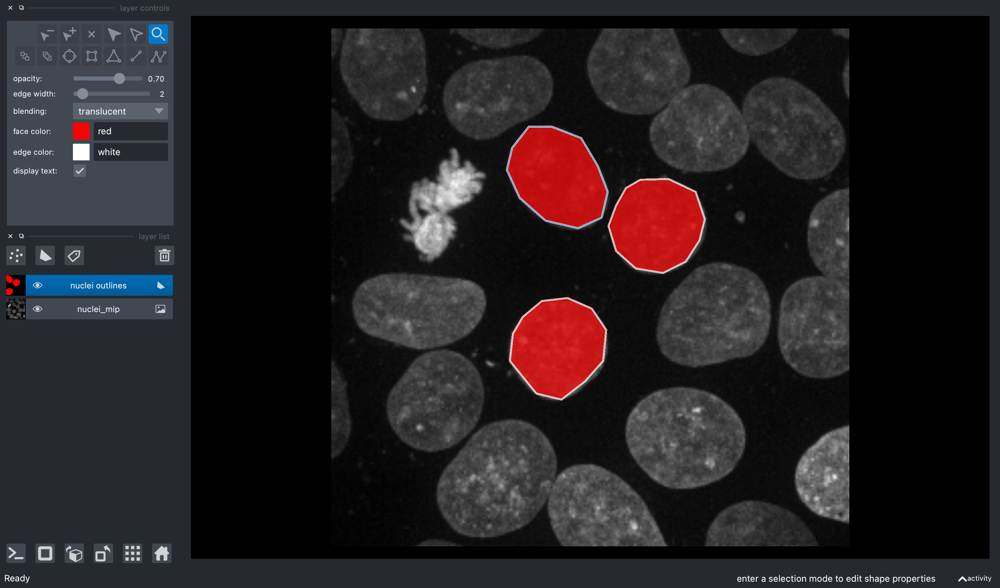

In [22]:
nbscreenshot(viewer)

In [23]:
# The list of vertices for each shape
viewer.layers['nuclei outlines'].data

[array([[142.12070325,  94.13481824],
        [150.36827772,  89.26125151],
        [163.86430869,  87.76169251],
        [179.98456789, 100.88283373],
        [182.98368588, 113.25419544],
        [173.98633191, 124.87577766],
        [163.86430869, 133.87313163],
        [148.49382898, 135.37269063],
        [137.99691601, 128.2497854 ],
        [132.74845952, 116.25331343],
        [134.24801852, 103.50706197]]),
 array([[ 87.01191015, 140.24625736],
        [ 97.13393338, 136.49735987],
        [109.50529509, 140.24625736],
        [118.12775932, 149.99339083],
        [120.37709781, 163.4894218 ],
        [114.75375158, 174.73611426],
        [104.25683861, 181.48412974],
        [ 93.75992564, 184.10835799],
        [ 80.26389467, 179.609681  ],
        [ 73.89076894, 166.11365004],
        [ 74.26565869, 152.24272933],
        [ 78.38944593, 145.1198241 ]]),
 array([[ 48.02337627, 108.3806287 ],
        [ 48.02337627,  97.13393624],
        [ 58.52028924,  88.88636176],
        

In [24]:
viewer.layers.save('nuclei-outlines.svg', plugin='svg')

'/Users/aburt/Programming/napari-workshop/napari-workshops/notebooks/nuclei-outlines.svg'

In [25]:
# Convert the polygons into labels
shape = viewer.layers['nuclei_mip'].data.shape
nuclei_labels = viewer.layers['nuclei outlines'].to_labels(labels_shape=shape)

print('Number of labels:', nuclei_labels.max())

Number of labels: 3


In [26]:
# Add the cell segmenation labels as a labels layer
viewer.add_labels(nuclei_labels);

# Turn off the visibility of the shapes layer so as not to get confused
viewer.layers['nuclei outlines'].visible = False

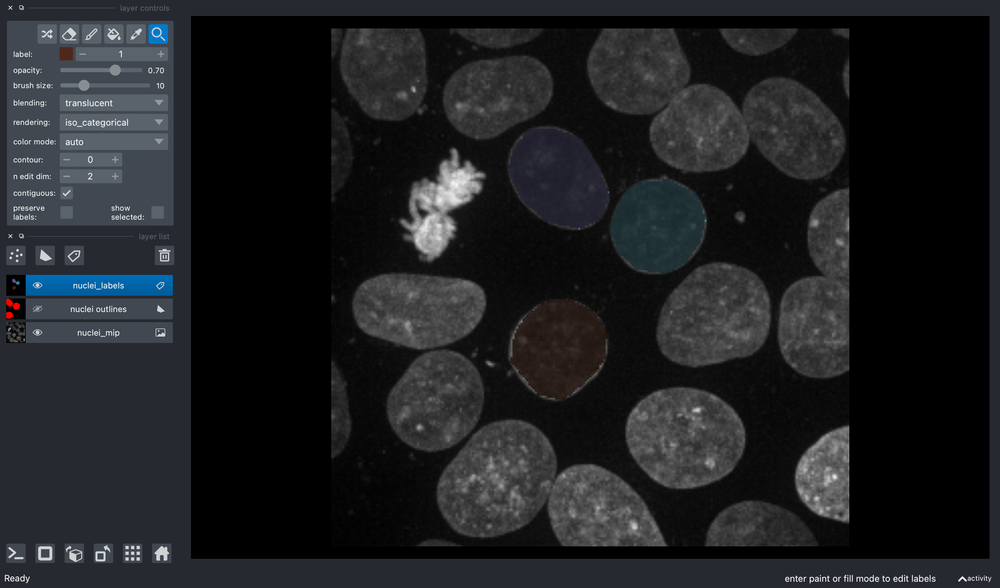

In [27]:
nbscreenshot(viewer)

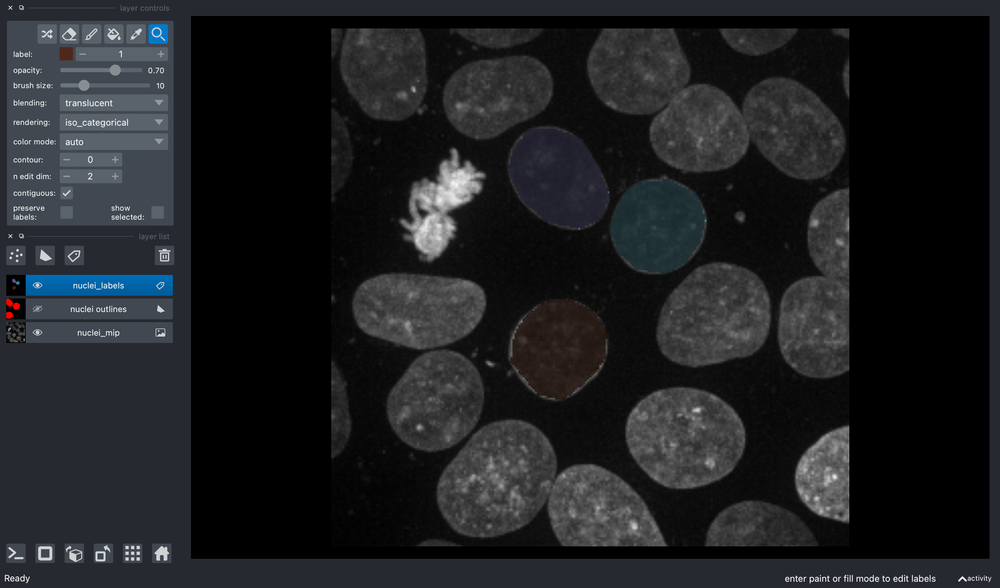

In [28]:
nbscreenshot(viewer)

In [29]:
# Save out the nuclei labels as a tiff file
viewer.layers['nuclei_labels'].save('nuclei-labels.tif', plugin='builtins');

In [30]:
# Note that the cell labels could be reloaded into the viewer as follows
viewer.open('nuclei-labels.tif', name='saved nuclei', plugin='builtins');

viewer.layers['nuclei_labels'].visible = False

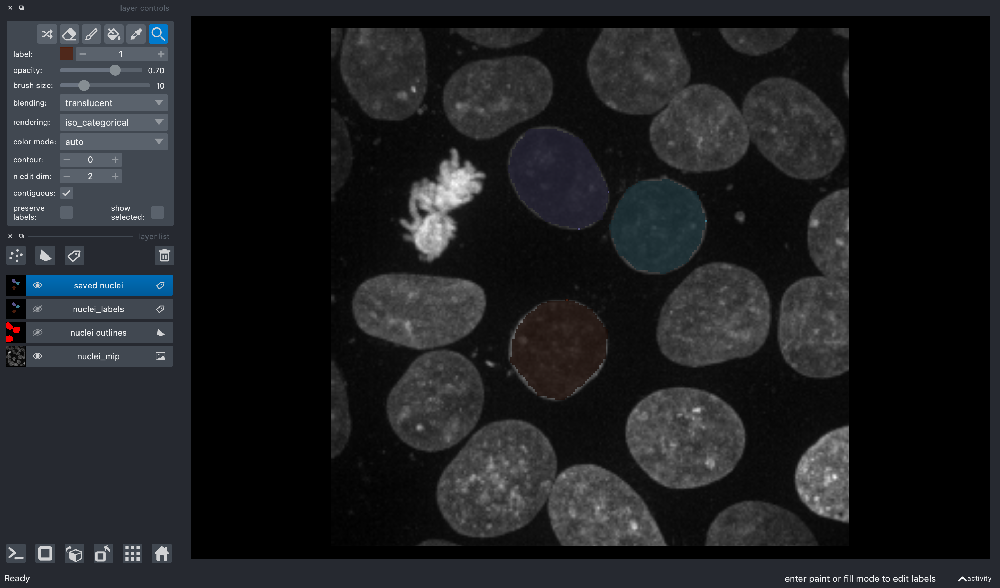

In [31]:
nbscreenshot(viewer)

In [32]:
n_labels = viewer.layers['nuclei_labels'].data.max()

ratios = []
for label_id in range(n_labels):
    inside_pixels = viewer.layers['nuclei_labels'].data == label_id
    area = inside_pixels.sum()
    signal = viewer.layers['nuclei_mip'].data[inside_pixels].sum()
    ratios.append(signal / area)
    
print('Signal per unit area for our labels:', ratios)

Signal per unit area for our labels: [0.20392785241398811, 0.36148807868385074, 0.3002928874264653]
